In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/atopyimage/atopy_11_14/val/red3/K-241.jpg
/kaggle/input/atopyimage/atopy_11_14/val/red3/K-985.jpg
/kaggle/input/atopyimage/atopy_11_14/val/red3/K-856.jpg
/kaggle/input/atopyimage/atopy_11_14/val/red3/K-1006.jpg
/kaggle/input/atopyimage/atopy_11_14/val/red3/K-421.jpg
/kaggle/input/atopyimage/atopy_11_14/val/red3/K-796.jpg
/kaggle/input/atopyimage/atopy_11_14/val/li3/K-726.jpg
/kaggle/input/atopyimage/atopy_11_14/val/li3/K-537.jpg
/kaggle/input/atopyimage/atopy_11_14/val/li3/K-609.jpg
/kaggle/input/atopyimage/atopy_11_14/val/li3/K-269.jpg
/kaggle/input/atopyimage/atopy_11_14/val/li3/K-674.jpg
/kaggle/input/atopyimage/atopy_11_14/val/li3/K-570.jpg
/kaggle/input/atopyimage/atopy_11_14/val/li1/K-455.jpg
/kaggle/input/atopyimage/atopy_11_14/val/li1/K-266.jpg
/kaggle/input/atopyimage/atopy_11_14/val/li1/K-277.jpg
/kaggle/input/atopyimage/atopy_11_14/val/li1/K-489.jpg
/kaggle/input/atopyimage/atopy_11_14/val/red2/K-810.jpg
/kaggle/input/atopyimage/atopy_11_14/val/red2/K-382.jpg
/

In [2]:
!pwd

/kaggle/working


In [3]:
import os
import numpy as np
from PIL import Image
from torchvision import transforms
from torch.utils.data import DataLoader

# Custom Dataset (map-style)

class AnimeFace:
    base_dir = "/kaggle/input/atopyimage/atopy_11_14/train"
    img_folder = "Scratch2"
    seed = 1234
    def __init__(self, split="all", transform=transforms.ToTensor()):
        self.imgs = self._get_images()
        self.total_size = len(self.imgs)
        train_inds, test_inds = self._get_split()
        self.inds = {
            "train": train_inds,
            "test": test_inds,
            "all": np.arange(self.total_size)
        }[split]
        self.transform = transform
        
    def _get_images(self):
        return sorted([
            f for f in os.listdir(os.path.join(self.base_dir, self.img_folder))
            if f.endswith(".jpg")], key=lambda x: x.zfill(14))
    
    def _get_split(self):
        inds = np.arange(self.total_size)
        np.random.seed(self.seed)
        np.random.shuffle(inds)
        split_at = int(self.total_size * 0.9) 
        train_inds, test_inds = inds[:split_at], inds[split_at:]
        return train_inds, test_inds
    
    def __len__(self):
        return len(self.inds)
    
    def __getitem__(self, idx):
        img_path = os.path.join(
            self.base_dir, self.img_folder, self.imgs[self.inds[idx]])
        with Image.open(img_path) as im:  # close the file before return
            return self.transform(im) if self.transform is not None else im
        

# train generative models on whole dataset
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.RandomHorizontalFlip(0.5),  # random horizontal flipping
    transforms.ToTensor(),  # 0..255 RGB to [0, 1] (C, H, W) Tensor
    transforms.Normalize((0.5, ) * 3, (0.5, ) * 3)  # rescale to [-1, 1]
])
traindata = AnimeFace(split="all", transform=transform)

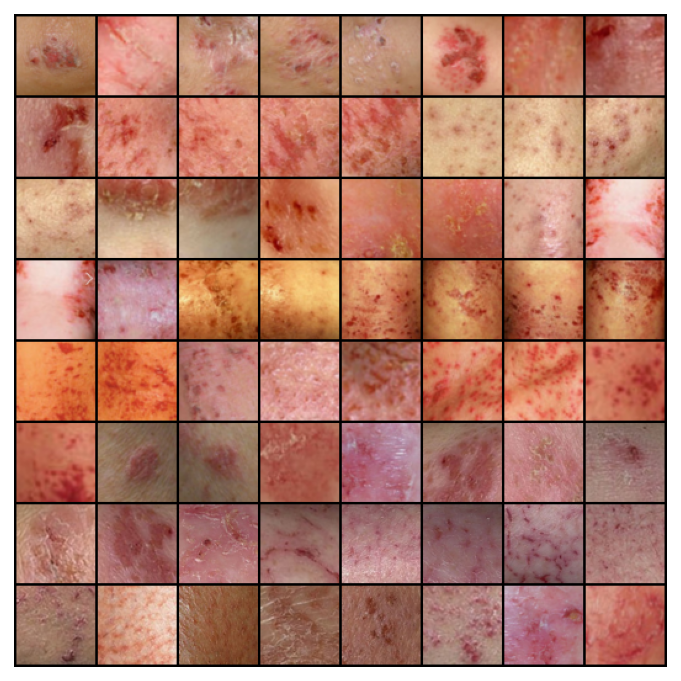

In [4]:
import torch
import matplotlib as mpl
mpl.rcParams["figure.dpi"] = 144

import matplotlib.pyplot as plt
from torchvision.utils import make_grid

x = torch.stack([traindata[i] for i in range(64)], dim=0)
img = make_grid(
    x, nrow=8,
    normalize=True, value_range=(-1, 1)).numpy().transpose(1, 2, 0)
plt.figure(figsize=(6, 6))
plt.imshow(img)
_ = plt.axis("off")

In [5]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import scipy.linalg


def l2_normalize(x, eps=1e-12):
    return x / (x.pow(2).sum() + eps).sqrt()


class SNLinear(nn.Module):
    dtype = torch.float32

    def __init__(self, in_ft, out_ft, bias=True, use_gamma=True, pow_iter=1, lip_const=1):
        super(SNLinear, self).__init__()
        self.in_ft = in_ft
        self.out_ft = out_ft
        self.use_gamma = use_gamma
        self.pow_iter = pow_iter
        self.lip_const = lip_const
        self.weight = nn.Parameter(torch.empty((out_ft, in_ft), dtype=self.dtype))
        if bias:
            self.register_parameter(
                "bias", nn.Parameter(torch.zeros((out_ft, ), dtype=self.dtype)))
        else:
            self.register_buffer("bias", None)
        self.lip_const = lip_const
        self.register_buffer("u", torch.randn((out_ft, ), dtype=self.dtype))
        if use_gamma:
            self.register_parameter(
                "gamma", nn.Parameter(torch.ones((1, ), dtype=self.dtype)))
        else:
            self.register_paramter("gamma", None)

        # initialize the parameters
        nn.init.kaiming_normal_(self.weight, a=0., mode="fan_in")

    def _init_gamma(self):
        if self.use_gamma:
            nn.init.constant_(
                self.gamma, scipy.linalg.svd(self.weight.data, compute_uv=False)[0])

    @property
    def weight_bar(self):
        sigma, u = self.power_iteration(self.weight, self.u, self.pow_iter)
        if self.training:
            self.u = u
        weight_bar = self.lip_const * self.weight / sigma
        if self.use_gamma:
            weight_bar = self.gamma * weight_bar
        return weight_bar
    
    @staticmethod
    def power_iteration(w, u_init, num_iter=1):
        # w: (F_out, F_in)
        # u_init: (F_out, )
        u = u_init
        with torch.no_grad():
            for _ in range(num_iter - 1):
                v = l2_normalize(u@w)
                u = l2_normalize(w@v)
            v = l2_normalize(u@w)
        wv = w@v  # note that this node allows gradient flow
        u = l2_normalize(wv.detach())
        sigma = u@wv
        return sigma, u

    def forward(self, x):
        return F.linear(x, self.weight_bar, self.bias)

    def extra_repr(self):
        return 'in_features={}, out_features={}, bias={}'.format(
            self.in_ft, self.out_ft, self.bias is not None
        )


class SNConv2d(nn.Module):
    dtype = torch.float32

    def __init__(self, in_ch, out_ch, ksz, stride, pad, bias=True, use_gamma=True, pow_iter=1, lip_const=1):
        super(SNConv2d, self).__init__()
        self.in_ch = in_ch
        self.out_ch = out_ch
        self.ksz = ksz
        self.stride = stride
        self.pad = pad
        self.use_gamma = use_gamma
        self.pow_iter = pow_iter
        self.lip_const = lip_const
        self.weight = nn.Parameter(
            torch.empty((out_ch, in_ch, ksz, ksz), dtype=self.dtype))
        if bias:
            self.register_parameter(
                "bias", nn.Parameter(torch.zeros((out_ch, ), dtype=self.dtype)))
        else:
            self.register_buffer("bias", None)
        self.lip_const = lip_const
        self.register_buffer("u", torch.randn((out_ch, ), dtype=self.dtype))
        if use_gamma:
            self.register_parameter(
                "gamma", nn.Parameter(torch.ones((1, ), dtype=self.dtype)))
        else:
            self.register_buffer("gamma", None)

        # initialize the parameters
        nn.init.kaiming_normal_(self.weight, a=0., mode="fan_in")

    def _init_gamma(self):
        if self.use_gamma:
            nn.init.constant_(
                self.gamma, scipy.linalg.svd(
                    self.weight.data.reshape(self.out_ch, -1), compute_uv=False)[0])

    def forward(self, x):
        return F.conv2d(x, self.weight_bar, self.bias, stride=self.stride, padding=self.pad)

    @property
    def weight_bar(self):
        sigma, u = self.power_iteration(self.weight, self.u, self.pow_iter)
        if self.training:
            self.u = u
        weight_bar = self.lip_const * self.weight / sigma
        if self.use_gamma:
            weight_bar = self.gamma * weight_bar
        return weight_bar
    
    @staticmethod
    def power_iteration(w, u_init, num_iter=1):
        # w: (c_out, C_in, K, K)
        # u_init: (c_out, )
        u = u_init
        with torch.no_grad():
            for _ in range(num_iter - 1):
                v = l2_normalize(torch.einsum("i,ijkl->jkl", u, w))
                u = l2_normalize(torch.einsum("ijkl,jkl->i", w, v))
            v = l2_normalize(torch.einsum("i,ijkl->jkl", u, w))
        wv = torch.einsum("ijkl,jkl->i", w, v)  # note that this node allows gradient flow
        u = l2_normalize(wv.detach())
        sigma = (u*wv).sum()
        return sigma, u

    def extra_repr(self):
        s = ('{in_ch}, {out_ch}, kernel_size={ksz}'
             ', stride={stride}')
        if self.pad != 0:
            s += ', padding={pad}'
        if self.bias is None:
            s += ', bias=False'
        return s.format(**self.__dict__)

In [6]:
# normalization
normD = lambda _: nn.Identity()  # no normalization for discriminator
actD = nn.ReLU


class BlockD(nn.Module):
    def __init__(self, in_ch, out_ch, downsample=False):
        super(BlockD, self).__init__()
        self.bn1 = normD(in_ch)
        self.act1 = actD(inplace=True)
        self.conv1 = SNConv2d(in_ch, out_ch, 3, 1+downsample, 1)
        self.bn2 = normD(out_ch)
        self.act2 = actD(inplace=True)
        self.conv2 = SNConv2d(out_ch, out_ch, 3, 1, 1)
        if in_ch == out_ch and not downsample:
            self.skip = nn.Identity()
        else:
            skip = [nn.AvgPool2d(2)] if downsample else []
            skip.append(SNConv2d(in_ch, out_ch, 1, 1, 0))
            self.skip = nn.Sequential(*skip)

    def forward(self, x):
        out = self.conv1(self.act1(self.bn1(x)))
        out = self.conv2(self.act2(self.bn2(out)))
        out += self.skip(x)
        return out


class NetD(nn.Module):
    def __init__(self, in_ch, base_ch=64, num_blocks=[2, 2, 2, 2]):
        super(NetD, self).__init__()
        self.in_block = BlockD(in_ch, base_ch, downsample=True)
        self.layer1 = self._make_layer(base_ch, 2 * base_ch, num_blocks[0])
        self.layer2 = self._make_layer(2 * base_ch, 4 * base_ch, num_blocks[1])
        self.layer3 = self._make_layer(4 * base_ch, 8 * base_ch, num_blocks[2])
        self.layer4 = self._make_layer(8 * base_ch, 16 * base_ch, num_blocks[3])
        self.out_fc = nn.Sequential(
            normD(16 * base_ch),
            actD(inplace=True),
            nn.AdaptiveAvgPool2d(1),
            nn.Flatten(start_dim=1),
            SNLinear(16 * base_ch, 1, bias=False)
        )

        # re-initialization
        for m in self.modules():
            if isinstance(m, (SNConv2d, SNLinear)):
                nn.init.kaiming_normal_(
                    m.weight, a=0., mode="fan_in", nonlinearity="leaky_relu")
                if m.use_gamma:
                    m._init_gamma()
                    
        # turn off in-place relu before the first conv layer
        self.in_block.act1 = nn.Identity()

    @staticmethod
    def _make_layer(in_ch, out_ch, num_blocks):
        return nn.Sequential(
            BlockD(in_ch, out_ch, downsample=True),
            *[BlockD(out_ch, out_ch) for _ in  range(num_blocks-1)])

    def forward(self, x):
        out = self.in_block(x)
        out = self.layer1(out)
        out = self.layer2(out)
        out = self.layer3(out)
        out = self.layer4(out)
        return self.out_fc(out)

In [7]:
# normalization
normG = nn.BatchNorm2d
actG = nn.ReLU


class Reshape(nn.Module):
    def __init__(self, shape):
        super(Reshape, self).__init__()
        self.shape = shape
    def forward(self, x):
        return x.reshape(self.shape)


class BlockG(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(BlockG, self).__init__()
        self.bn1 = normG(in_ch)
        self.act1 = actG(inplace=True)
        self.conv1 = nn.Conv2d(in_ch, out_ch, 3, 1, 1, bias=False)
        self.bn2 = normG(out_ch)
        self.act2 = actG(inplace=True)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, 1, 1, bias=False)
        if in_ch == out_ch:
            self.skip = nn.Identity()
        else:
            self.skip = nn.Conv2d(in_ch, out_ch, 1, 1, 0, bias=False)

    def forward(self, x):
        out = self.conv1(self.act1(self.bn1(x)))
        out = self.conv2(self.act2(self.bn2(out)))
        out += self.skip(x)
        return out


class NetG(nn.Module):
    def __init__(self, in_ch, base_ch=64, latent_dim=128, num_blocks=[2, 2, 2, 2]):
        super(NetG, self).__init__()
        self.in_fc = nn.Sequential(
            nn.Linear(latent_dim, 16 * base_ch * 4 ** 2, bias=False), Reshape((-1, 16 * base_ch, 4, 4)))
        self.layer1 = self._make_layer(16 * base_ch, 8 * base_ch, num_blocks[0])
        self.layer2 = self._make_layer(8 * base_ch, 4 * base_ch, num_blocks[1])
        self.layer3 = self._make_layer(4 * base_ch, 2 * base_ch, num_blocks[2])
        self.layer4 = self._make_layer(2 * base_ch, base_ch, num_blocks[3])
        self.out_conv = nn.Sequential(
            normG(base_ch),
            actG(inplace=True),
            nn.Conv2d(base_ch, in_ch, 1, 1, 0),
            nn.Tanh()
        )

        # re-initialization
        for m in self.modules():
            if isinstance(m, (nn.Linear, nn.Conv2d)):
                nn.init.kaiming_normal_(
                    m.weight, a=0., mode="fan_in", nonlinearity="leaky_relu")
                
        self.latent_dim = latent_dim

    @staticmethod
    def _make_layer(in_ch, out_ch, num_blocks):
        return nn.Sequential(
            nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True),
            BlockG(in_ch, out_ch),
            *[BlockG(out_ch, out_ch) for _ in  range(num_blocks-1)])

    def forward(self, x):
        out = self.in_fc(x)
        out = self.layer1(out)
        out = self.layer2(out)
        out = self.layer3(out)
        out = self.layer4(out)
        return self.out_conv(out)
    
    def sample(self, n, noise=None):
        device = next(self.parameters()).device
        if noise is None:
            noise = torch.randn((n, self.latent_dim))
        return self.forward(noise.to(device))

In [8]:
from torch.optim import Adam
from tqdm import tqdm
from collections import OrderedDict

# build dataloader
traindata = AnimeFace(split="all", transform=transform)
batch_size = 16

trainloader = DataLoader(
    traindata, shuffle=True, batch_size=batch_size, drop_last=True, pin_memory=True, num_workers=os.cpu_count())

# training hyparameters
lr = 0.0002
beta1 = 0.0
beta2 = 0.9

# training on gpu is preferred
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# model hyparameters
in_ch = 3
base_ch = 64
latent_dim = 128

# build discriminator and generator
netD = NetD(in_ch, base_ch, [1, 1, 1, 1])
netG = NetG(in_ch, base_ch, latent_dim, [1, 1, 1, 1])

# send models to device
netD.to(device)
netG.to(device)

# build optimizers
optD = Adam(netD.parameters(), lr=lr, betas=(beta1, beta2))
optG = Adam(netG.parameters(), lr=lr, betas=(beta1, beta2))


class EMA:
    """
    exponential moving average
    """
    def __init__(self, model, decay=0.9999):
        self.shadow = OrderedDict([
            (k, v.clone().detach())
            for k,v in model.named_parameters()])
        self.decay = decay
        self.num_updates = 0
        
    def update(self, params):
        self.num_updates += 1
        decay = min(self.decay, (1 + self.num_updates) / (10 + self.num_updates))
        for k, v in params:
            self.shadow[k] += (1 - decay) * (v.detach() - self.shadow[k])

    def apply(self, model):
        self.original =  OrderedDict([
            (k, v.clone().detach())
            for k,v in model.named_parameters()])
        for k, v in model.named_parameters():
            v.data.copy_(self.shadow[k])

    def restore(self, model):
        for k,v in model.named_parameters():
            v.data.copy_(self.original[k])
        del self.original

ema = EMA(netG)

# hinge loss
loss_fn_D = lambda x, y: torch.clamp(1-x*y, min=0).mean()
loss_fn_G = lambda x, _: x.neg().mean()

n_dis = 1  # number of discriminator updates per iteration
g_batches = 2
def train_step(i, x_real):
    # netD step
    cnt = x_real.shape[0]
    with torch.no_grad():
        x_fake = netG.sample(cnt)
    dis_loss = loss_fn_D(
        netD(x_real.to(device)), torch.ones((cnt, 1), device=device))
    dis_loss += loss_fn_D(
        netD(x_fake), -torch.ones((cnt, 1), device=device))
    dis_loss.backward()
    optD.step()
    netD.zero_grad(set_to_none=True)
    
    gen_loss = torch.as_tensor(0)
    # update G every n_dis minibatch = update D n_dis times before G update
    if i % n_dis == 0:  
        # netG step
        for _ in range(g_batches):
            x_fake = netG.sample(cnt)
            gen_loss = loss_fn_G(
                netD(x_fake), torch.ones((cnt, 1), device=device))
            gen_loss.backward()
        optG.step()
        netD.zero_grad(set_to_none=True)
        netG.zero_grad(set_to_none=True)
        ema.update(netG.named_parameters())
    return cnt, dis_loss.item(), gen_loss.item()

In [12]:

!mkdir scratch2

mkdir: cannot create directory ‘scratch2’: File exists


In [13]:
# fixed latent code for image generation over training period
torch.manual_seed(1234)
fixed_noise = torch.fmod(torch.randn((64, latent_dim), device=device), 2)

chkpt_intv = 10  # save a checkpoint every 5 epochs
output_dir = "/kaggle/working/scratch2"
chkpt_path = os.path.join(output_dir, "atopy_scratch2.pt")

if torch.backends.cudnn.is_available():
    torch.backends.cudnn.benchmark = True

# total epochs to train
n_epochs = 500
for e in range(n_epochs):
    total_dis_loss = 0
    total_gen_loss = 0
    total_dis_cnt = 0
    total_gen_cnt = 0
    with tqdm(trainloader, desc=f"{e+1}/{n_epochs} epochs", ncols=100) as t:
        netG.train()
        gen_loss = 0
        for i, x_real in enumerate(t):
            cnt, dis_loss, gen_loss_ = train_step(i, x_real)
            gen_loss = gen_loss_ or gen_loss
            # keep track of running statistics
            total_dis_loss += dis_loss * cnt 
            total_dis_cnt += cnt
            total_gen_loss += gen_loss * cnt * g_batches
            total_gen_cnt += cnt * g_batches

            t.set_postfix({
                "dis_loss": total_dis_loss / total_dis_cnt,
                "gen_loss": total_gen_loss / total_gen_cnt
            })
            if i == len(trainloader) - 1:
                netG.eval()
                with torch.no_grad():
                    ema.apply(netG)
                    x = netG.sample(64, fixed_noise).cpu()
                    ema.restore(netG)
                img = make_grid(
                    x, nrow=8, normalize=True, value_range=(-1, 1)
                ).numpy().transpose(1, 2, 0)
                plt.imsave(os.path.join(output_dir, f"{e+1}.jpg"), img)
                if (e+1) % chkpt_intv == 0:
                    torch.save(
                        {
                            "netD": netD.state_dict(),
                            "netG": netG.state_dict(),
                            "optD": optD.state_dict(),
                            "optG": optG.state_dict(),
                            "ema": ema.__dict__,
                            "epoch": e+1
                        }, chkpt_path)

500/500 epochs: 100%|███████████████| 11/11 [00:04<00:00,  2.72it/s, dis_loss=0.0585, gen_loss=2.21]


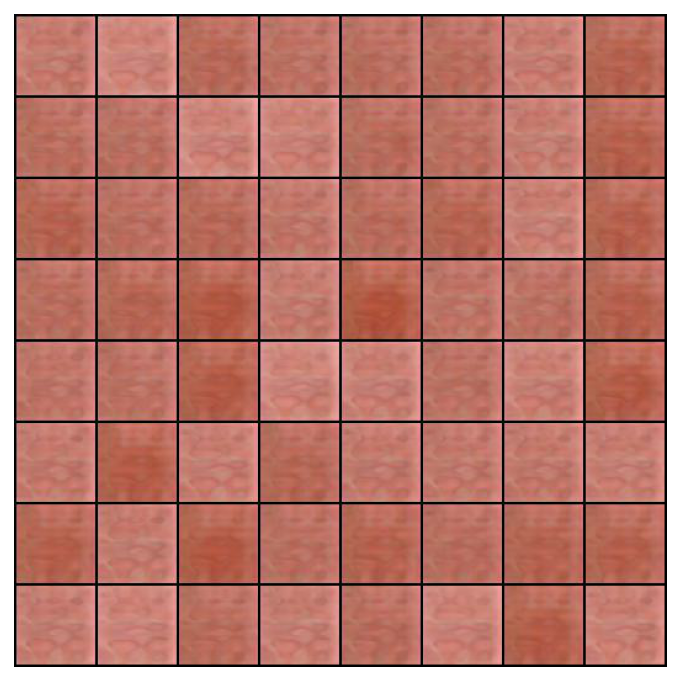

In [14]:
import matplotlib.animation as anim
from IPython.display import HTML

imgs = sorted([
    f for f in os.listdir(output_dir) 
    if f.endswith(".jpg")], key=lambda x: int(x[:-4]))
ims = []

fig = plt.figure(figsize=(6, 6))
for f in imgs:
    ims.append([plt.imshow(plt.imread(os.path.join(output_dir, f)), animated=True)])
plt.axis("off")
ani = anim.ArtistAnimation(fig, ims, interval=200, blit=True, repeat_delay=1000)
HTML(ani.to_jshtml())

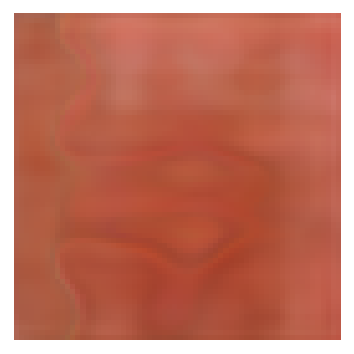

In [15]:
n_samp = 4
noise = torch.fmod(torch.randn((n_samp, 128), device=device), 2)

intp = torch.linspace(0, 1, 25)[:-1]
intp = torch.stack([1-intp, intp], dim=1).to(device)
xs = []
ema.apply(netG)
with torch.no_grad():
    for i in range(4):
        xs.append(netG(intp@noise[[i%4, (i+1)%4]]).cpu())
ema.restore(netG)
xs = torch.cat(xs, dim=0).numpy().transpose(0, 2, 3, 1)
xs = (xs + 1) / 2
fig = plt.figure(figsize=(3, 3))
plt.axis("off")
ims = [[plt.imshow(x, animated=True)] for x in xs]
ani = anim.ArtistAnimation(fig, ims, interval=42, repeat_delay=42, blit=True)
HTML(ani.to_jshtml())